In [83]:
import pandas as pd
import os  
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import probabl

In [84]:
import skrub

In [85]:
os.chdir("../data")
df= pd.read_csv("quejas-clientes.csv", sep=",", )
df.drop(columns=["Unnamed: 0"], inplace=True)
df

,Complaint ID,Product,Sub-product,Issue,Sub-issue,State,ZIP code,Date received,Date sent to company,Company,Company response,Timely response?,Consumer disputed?
0,1291006,Debt collection,NaN,Communication tactics,Frequent or repeated calls,TX,76119.0,2015-03-19,2015-03-19,"Premium Asset Services, LLC",In progress,Yes,NaN
1,1290580,Debt collection,Medical,Cont'd attempts collect debt not owed,Debt is not mine,TX,77479.0,2015-03-19,2015-03-19,Accounts Receivable Consultants Inc.,Closed with explanation,Yes,NaN
2,1290564,Mortgage,FHA mortgage,"Application, originator, mortgage broker",NaN,MA,2127.0,2015-03-19,2015-03-19,RBS Citizens,Closed with explanation,Yes,Yes
3,1291615,Credit card,NaN,Other,NaN,CA,92592.0,2015-03-19,2015-03-19,Navy FCU,In progress,Yes,NaN
4,1292165,Debt collection,Non-federal student loan,Cont'd attempts collect debt not owed,Debt resulted from identity theft,NaN,43068.0,2015-03-19,2015-03-19,Transworld Systems Inc.,In progress,Yes,NaN
5,1291176,Debt collection,Payday loan,Communication tactics,Called after sent written cease of comm,OH,43068.0,2015-03-19,2015-03-19,ACE Cash Express Inc.,In progress,Yes,NaN
6,1288848,Consumer loan,Installment loan,Managing the loan or lease,NaN,OH,44241.0,2015-03-18,2015-03-18,"CashCall, Inc.",Closed with explanation,Yes,Yes
7,1288788,Debt collection,Payday loan,Communication tactics,Called after sent written cease of comm,CA,95124.0,2015-03-18,2015-03-18,ACE Cash Express Inc.,Closed with explanation,Yes,NaN
8,1288324,Debt collection,"Other (phone, health club, etc.)",Cont'd attempts collect debt not owed,Debt was paid,NJ,7067.0,2015-03-18,2015-03-18,"Credit Protection Association, L.P.",Closed with non-monetary relief,Yes,NaN
9,1288304,Debt collection,Payday loan,Taking/threatening an illegal action,Threatened arrest/jail if do not pay,TX,77433.0,2015-03-18,2015-03-18,Cottonwood Financial Ltd.,Closed with explanation,Yes,Yes


In [86]:
print(df["Date sent to company"].min())
print(df["Date sent to company"].max())

2015-01-01
2015-03-19


In [87]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28156 entries, 0 to 28155
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Complaint ID          28156 non-null  int64  
 1   Product               28156 non-null  object 
 2   Sub-product           17582 non-null  object 
 3   Issue                 28154 non-null  object 
 4   Sub-issue             13211 non-null  object 
 5   State                 27735 non-null  object 
 6   ZIP code              27876 non-null  float64
 7   Date received         28156 non-null  object 
 8   Date sent to company  28156 non-null  object 
 9   Company               28156 non-null  object 
 10  Company response      28156 non-null  object 
 11  Timely response?      28156 non-null  object 
 12  Consumer disputed?    6006 non-null   object 
dtypes: float64(1), int64(1), object(11)
memory usage: 2.8+ MB


In [88]:
from skrub import TableReport
TableReport(df.fillna("not_specified"))

Processing column  13 / 13


,,,,,,,,,,,,,


Prece que las fechas estan en orden.


La respuesta de la compañia es lo que mas importa con una respuesta a tiempo (0.7 de Cramer). Sin embargo, parece que el producto no tiene demasiada importancia en en Consumer disputed?




In [89]:
sorted(df["State"].dropna().unique())



['AE',
 'AK',
 'AL',
 'AP',
 'AR',
 'AS',
 'AZ',
 'CA',
 'CO',
 'CT',
 'DC',
 'DE',
 'FL',
 'GA',
 'GU',
 'HI',
 'IA',
 'ID',
 'IL',
 'IN',
 'KS',
 'KY',
 'LA',
 'MA',
 'MD',
 'ME',
 'MH',
 'MI',
 'MN',
 'MO',
 'MS',
 'MT',
 'NC',
 'ND',
 'NE',
 'NH',
 'NJ',
 'NM',
 'NV',
 'NY',
 'OH',
 'OK',
 'OR',
 'PA',
 'PR',
 'PW',
 'RI',
 'SC',
 'SD',
 'TN',
 'TX',
 'UT',
 'VA',
 'VI',
 'VT',
 'WA',
 'WI',
 'WV',
 'WY']

In [90]:
df["State"].value_counts()

State
CA    3859
FL    2592
TX    2380
NY    1846
GA    1146
NJ    1113
PA    1055
IL    1003
OH     939
VA     869
MD     791
NC     764
MI     694
AZ     578
MA     512
WA     509
CO     483
TN     473
SC     441
MO     409
AL     358
NV     351
WI     351
OR     337
MN     311
IN     298
CT     287
LA     277
KY     225
OK     207
UT     176
KS     176
DC     168
MS     159
NM     155
DE     152
IA     141
AR     121
ME     115
ID     115
NH     111
NE     108
RI      89
HI      83
WV      70
PR      65
VT      55
SD      52
MT      41
ND      30
WY      30
AK      25
AP      17
AE       9
VI       7
GU       3
MH       2
PW       1
AS       1
Name: count, dtype: int64

<Axes: xlabel='State'>

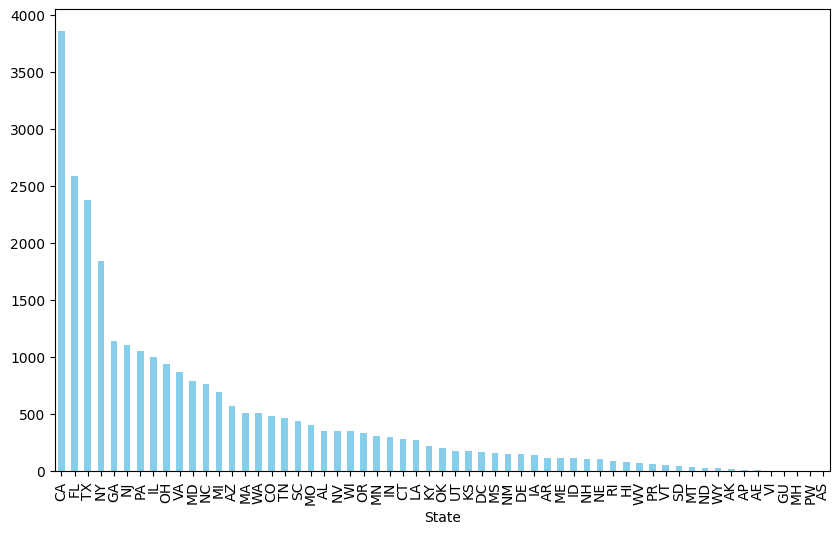

In [91]:
plt.figure(figsize=(10, 6))
df["State"].value_counts().plot(kind="bar", color="skyblue")

Son los 50 estados de EEUU, otros territorios controlados por el(	Puerto Rico, Islas Vírgenes, Guam, Samoa Americana, Islas Marshall, Palaos ) y dos designagiones militares (AE es europea, y AP del pacifico).


In [92]:
df["State"].dropna().value_counts().sort_values(ascending=False)

State
CA    3859
FL    2592
TX    2380
NY    1846
GA    1146
NJ    1113
PA    1055
IL    1003
OH     939
VA     869
MD     791
NC     764
MI     694
AZ     578
MA     512
WA     509
CO     483
TN     473
SC     441
MO     409
AL     358
NV     351
WI     351
OR     337
MN     311
IN     298
CT     287
LA     277
KY     225
OK     207
UT     176
KS     176
DC     168
MS     159
NM     155
DE     152
IA     141
AR     121
ME     115
ID     115
NH     111
NE     108
RI      89
HI      83
WV      70
PR      65
VT      55
SD      52
MT      41
ND      30
WY      30
AK      25
AP      17
AE       9
VI       7
GU       3
MH       2
PW       1
AS       1
Name: count, dtype: int64

Es posible que se eliminen los estados AP y AE ya que son bases militares y existen pocas quejas y son vinculantes.

<Axes: xlabel='State', ylabel='Percent'>

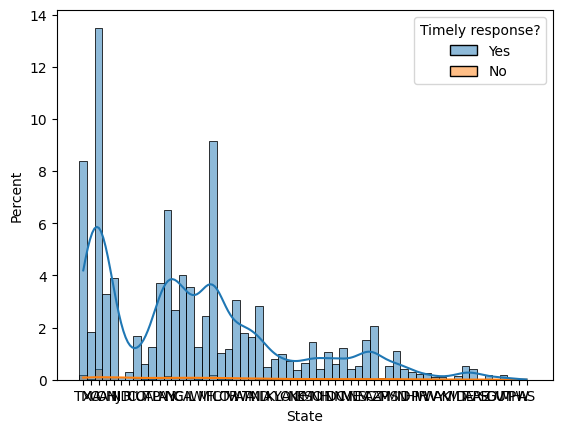

In [93]:
sns.histplot(data=df, x= "State", hue="Timely response?", kde=True, stat="percent")

Hay muy pocos casos de timely response no y no se puede ver

---


<Axes: xlabel='State', ylabel='Count'>

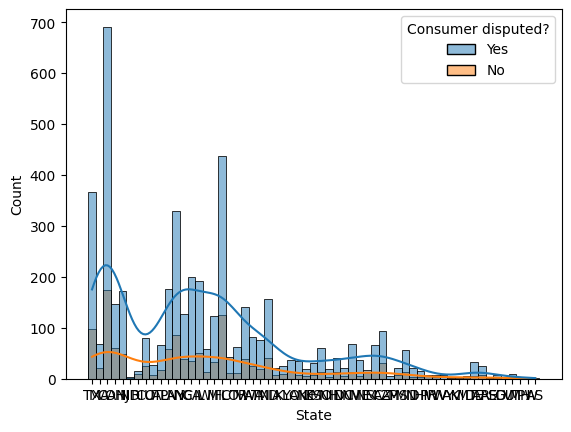

In [94]:
sns.histplot(data=df, x= "State", hue="Consumer disputed?", kde=True)


No parece que haya mucha diferencia en los estados.

In [95]:
df["ZIP code"].value_counts()

ZIP code
76116.0    58
33173.0    39
33614.0    38
85032.0    37
60445.0    36
22192.0    35
95825.0    33
29730.0    30
20001.0    30
92663.0    28
77489.0    28
63114.0    27
79424.0    26
30044.0    25
48382.0    25
32904.0    25
77020.0    24
10031.0    24
94606.0    23
4605.0     23
10456.0    23
90047.0    23
77065.0    22
89128.0    22
8753.0     21
21117.0    21
30122.0    20
43615.0    20
60640.0    20
76018.0    20
20774.0    20
92880.0    20
7712.0     20
92656.0    20
7801.0     20
78723.0    20
33414.0    19
15221.0    19
20878.0    19
30349.0    19
30024.0    19
11372.0    18
37013.0    18
33016.0    18
91604.0    18
75203.0    18
35040.0    17
7753.0     17
1890.0     17
91325.0    17
53072.0    17
10001.0    17
19701.0    17
33023.0    17
92592.0    16
19143.0    16
93065.0    16
76132.0    16
33177.0    16
77084.0    16
2136.0     16
32218.0    16
22030.0    16
90025.0    16
20036.0    16
28269.0    16
94804.0    15
20744.0    15
23454.0    15
92101.0    15
30331.0    

Parece que los codigos postales no son homogeneos. Hay como 9800 codigos distintos y algunos estan mas poblados que otros. Se podria intentar utilizarlos para predecir algo, pero en cierta manera se puede vinular con los clientes, y se intentara eevitarlo. Ademas esto es una categoria no un numero y hay como 9800, y se se hace onehot encocding y el metodo no hace nada para evitarlo.

In [96]:
df["ZIP code"].value_counts().sum()

np.int64(27876)

In [97]:
(df[df["ZIP code"].isna()==True]["State"]).value_counts().sum()

np.int64(126)

In [98]:
print("estradas sin codigo postal:", len((df[df["ZIP code"].isna()==True]["Complaint ID"]).to_list()))
print(len((df[df["ZIP code"].isna()==True]["State"])))
df[df["ZIP code"].isna()]["State"].value_counts()

estradas sin codigo postal: 280
280


State
NV    67
CT    30
NY     5
TX     4
CA     3
FL     2
OH     2
NM     2
TN     1
NC     1
SC     1
MT     1
UT     1
ME     1
WY     1
GA     1
LA     1
MI     1
AK     1
Name: count, dtype: int64

In [99]:
print(len(df[df["State"].isna()==True]["ZIP code"].to_list()))
df[df["State"].isna()==True]["ZIP code"].to_list()

421


[43068.0,
 nan,
 33027.0,
 32174.0,
 95476.0,
 19468.0,
 75240.0,
 75240.0,
 20658.0,
 30344.0,
 30344.0,
 nan,
 18536.0,
 91752.0,
 23228.0,
 nan,
 74743.0,
 74743.0,
 80125.0,
 43452.0,
 30036.0,
 nan,
 43452.0,
 44305.0,
 72719.0,
 31632.0,
 nan,
 795.0,
 54880.0,
 54880.0,
 95948.0,
 95948.0,
 99001.0,
 47304.0,
 47304.0,
 67213.0,
 85614.0,
 960.0,
 nan,
 nan,
 9620.0,
 nan,
 28697.0,
 28697.0,
 94960.0,
 34769.0,
 33063.0,
 20004.0,
 95630.0,
 94960.0,
 nan,
 33166.0,
 12000.0,
 nan,
 7067.0,
 nan,
 nan,
 34778.0,
 77534.0,
 20.0,
 20.0,
 77534.0,
 nan,
 10011.0,
 98115.0,
 45342.0,
 98115.0,
 74432.0,
 86403.0,
 nan,
 53805.0,
 33144.0,
 33144.0,
 68776.0,
 78209.0,
 68776.0,
 98008.0,
 nan,
 nan,
 78209.0,
 nan,
 nan,
 nan,
 45245.0,
 89523.0,
 60612.0,
 45014.0,
 89523.0,
 707.0,
 nan,
 53240.0,
 nan,
 nan,
 34654.0,
 34654.0,
 95368.0,
 28278.0,
 95368.0,
 33189.0,
 33189.0,
 1128.0,
 1128.0,
 nan,
 35243.0,
 33615.0,
 33615.0,
 nan,
 7470.0,
 nan,
 70005.0,
 715.0,
 nan,
 na

Hay 280 entradas sin codigo postal de esos 126 si que tienen estado.
Hay varias que que no tienen estado pero si postal. Se podria intentar sacar el estado  a partir de una API

<Axes: xlabel='ZIP code', ylabel='Count'>

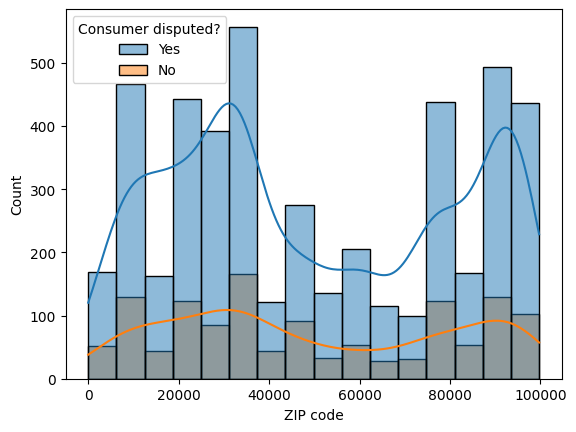

In [100]:
sns.histplot(data=df, x= "ZIP code", hue="Consumer disputed?", kde=True)

El codigo zip en un como distinto peor podria ser porque tiene menos muestras

---

In [101]:
df.fillna("Unknown or not specified", inplace=True)

C:\Users\unaif\AppData\Local\Temp\ipykernel_10840\4206166486.py:1: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Unknown or not specified' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  df.fillna("Unknown or not specified", inplace=True)


In [102]:
df["Product"].value_counts()

Product
Debt collection            7494
Mortgage                   6612
Credit reporting           5717
Credit card                2830
Bank account or service    2609
Consumer loan              1314
Student loan                785
Payday loan                 348
Money transfers             232
Prepaid card                175
Other financial service      40
Name: count, dtype: int64

<Axes: xlabel='Product'>

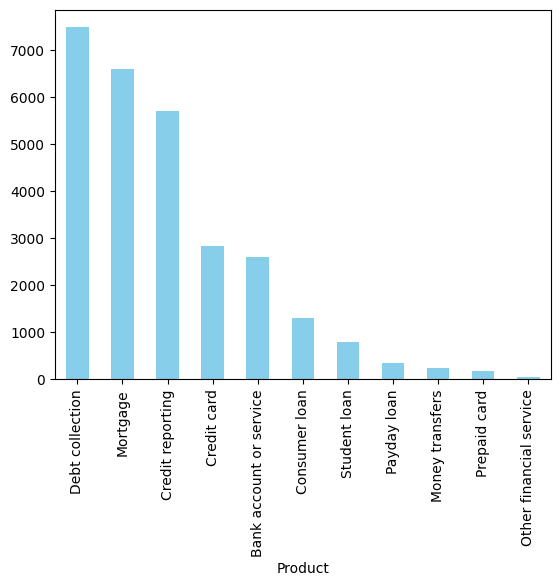

In [103]:
df["Product"].value_counts().plot(kind="bar", color="skyblue")

In [104]:
df["Product"].nunique()

11

<Axes: xlabel='Product', ylabel='Count'>

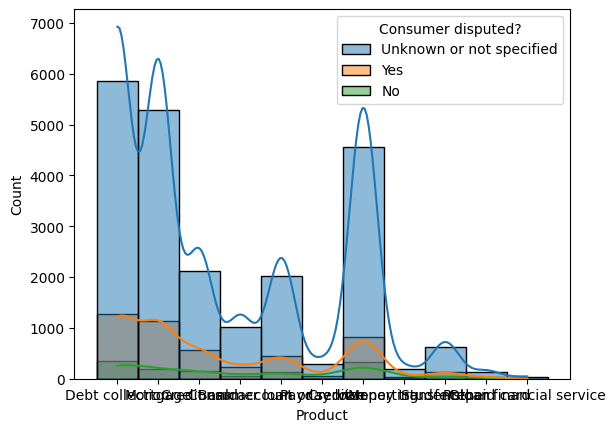

In [105]:
sns.histplot(data=df, x= "Product", hue="Consumer disputed?", kde=True)

In [106]:
df["Sub-product"].value_counts()

Sub-product
Unknown or not specified                  10574
Conventional fixed mortgage                2446
Other (phone, health club, etc.)           2273
Other mortgage                             1954
Checking account                           1693
Credit card                                1447
Medical                                    1135
Non-federal student loan                    911
FHA mortgage                                853
Conventional adjustable mortgage (ARM)      800
Vehicle loan                                721
Other bank product/service                  629
Payday loan                                 397
Installment loan                            386
Home equity loan or line of credit          329
VA mortgage                                 180
Mortgage                                    169
Savings account                             166
Auto                                        164
International money transfer                131
Vehicle lease               

En subproducto ya tiene la catecogira other, aun asi hay como 10000 quejas sin un subproducto.

In [107]:
df[df["Sub-product"].isnull()]

,Complaint ID,Product,Sub-product,Issue,Sub-issue,State,ZIP code,Date received,Date sent to company,Company,Company response,Timely response?,Consumer disputed?


Voy a sacarlas categorias de cada features

In [108]:
df[df["Sub-product"].isnull()]["Product"].unique()

array([], dtype=object)

In [109]:
df[df["Sub-product"].notnull()]["Product"].unique()

array(['Debt collection', 'Mortgage', 'Credit card', 'Consumer loan',
       'Bank account or service', 'Payday loan', 'Credit reporting',
       'Money transfers', 'Student loan', 'Prepaid card',
       'Other financial service'], dtype=object)

In [110]:
for i in df[df["Sub-product"].notnull()]["Product"].unique():
    print(i, ":", df[df["Product"]==i]["Sub-product"].unique())

Debt collection : ['Unknown or not specified' 'Medical' 'Non-federal student loan'
 'Payday loan' 'Other (phone, health club, etc.)' 'Credit card' 'Mortgage'
 'Auto' 'Federal student loan']
Mortgage : ['FHA mortgage' 'Conventional adjustable mortgage (ARM)'
 'Conventional fixed mortgage' 'Home equity loan or line of credit'
 'Other mortgage' 'VA mortgage' 'Reverse mortgage']
Credit card : ['Unknown or not specified']
Consumer loan : ['Installment loan' 'Vehicle loan' 'Personal line of credit'
 'Vehicle lease' 'Pawn loan' 'Title loan']
Bank account or service : ['Other bank product/service' 'Checking account'
 '(CD) Certificate of deposit' 'Savings account'
 'Cashing a check without an account']
Payday loan : ['Unknown or not specified']
Credit reporting : ['Unknown or not specified']
Money transfers : ['Domestic (US) money transfer' 'International money transfer']
Student loan : ['Non-federal student loan']
Prepaid card : ['General purpose card' 'Other special purpose card'
 'Gift or m

In [111]:
for i in df["Product"].unique():
    print(i, ":", df[df["Product"]==i]["Issue"].unique())

Debt collection : ['Communication tactics' "Cont'd attempts collect debt not owed"
 'Taking/threatening an illegal action'
 'False statements or representation' 'Disclosure verification of debt'
 'Improper contact or sharing of info']
Mortgage : ['Application, originator, mortgage broker'
 'Loan modification,collection,foreclosure'
 'Loan servicing, payments, escrow account'
 'Credit decision / Underwriting' 'Settlement process and costs' 'Other']
Credit card : ['Other' 'Delinquent account' 'Late fee' 'Billing statement'
 'Cash advance fee' 'APR or interest rate' 'Closing/Cancelling account'
 'Billing disputes' 'Identity theft / Fraud / Embezzlement' 'Bankruptcy'
 'Credit card protection / Debt protection' 'Payoff process'
 'Credit determination' 'Customer service / Customer relations'
 'Unsolicited issuance of credit card' 'Privacy' 'Transaction issue'
 'Application processing delay' 'Balance transfer fee'
 'Credit line increase/decrease' 'Balance transfer'
 'Advertising and marketing

In [112]:
for i in df["Issue"].unique():
    print(i, ":", df[df["Issue"]==i]["Sub-issue"].unique())

Communication tactics : ['Frequent or repeated calls' 'Called after sent written cease of comm'
 'Used obscene/profane/abusive language' 'Threatened to take legal action'
 'Called outside of 8am-9pm']
Cont'd attempts collect debt not owed : ['Debt is not mine' 'Debt resulted from identity theft' 'Debt was paid'
 'Debt was discharged in bankruptcy']
Application, originator, mortgage broker : ['Unknown or not specified']
Other : ['Unknown or not specified']
Managing the loan or lease : ['Unknown or not specified']
Taking/threatening an illegal action : ['Threatened arrest/jail if do not pay'
 'Threatened to sue on too old debt'
 'Sued w/o proper notification of suit'
 'Seized/Attempted to seize property'
 "Sued where didn't live/sign for debt"
 'Attempted to/Collected exempt funds']
False statements or representation : ['Impersonated an attorney or official'
 'Attempted to collect wrong amount'
 'Indicated committed crime not paying'
 "Indicated shouldn't respond to lawsuit"]
Deposits an

<Axes: xlabel='Sub-product', ylabel='Count'>

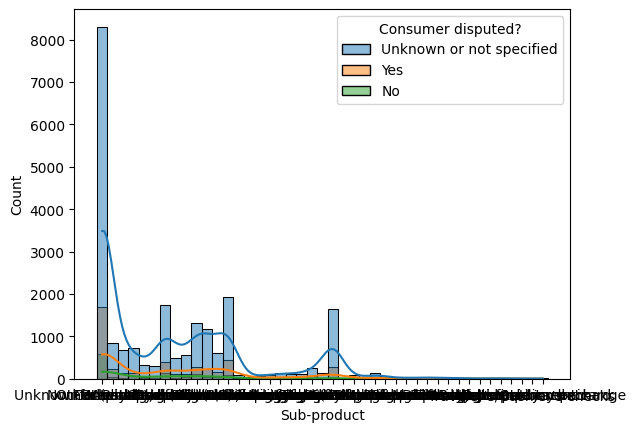

In [113]:
sns.histplot(data=df, x= "Sub-product", hue="Consumer disputed?", kde=True)

No parece que haya diferencia en la poblacion

----

In [114]:
df["Company response"].unique()

array(['In progress', 'Closed with explanation',
       'Closed with non-monetary relief', 'Closed',
       'Closed with monetary relief', 'Untimely response'], dtype=object)

In [115]:
df[df["Company response"]=="In progress"]["Consumer disputed?"].value_counts()

Consumer disputed?
Unknown or not specified    2690
Name: count, dtype: int64

In [116]:
df[df["Company response"]=="Closed with non-monetary relief"]

,Complaint ID,Product,Sub-product,Issue,Sub-issue,State,ZIP code,Date received,Date sent to company,Company,Company response,Timely response?,Consumer disputed?
8,1288324,Debt collection,"Other (phone, health club, etc.)",Cont'd attempts collect debt not owed,Debt was paid,NJ,7067.0,2015-03-18,2015-03-18,"Credit Protection Association, L.P.",Closed with non-monetary relief,Yes,Unknown or not specified
14,1289900,Debt collection,"Other (phone, health club, etc.)",Disclosure verification of debt,Not given enough info to verify debt,UT,84405.0,2015-03-18,2015-03-18,Account Liquidation Services Inc.,Closed with non-monetary relief,Yes,Yes
52,1287443,Credit reporting,Unknown or not specified,Incorrect information on credit report,Personal information,MI,48473.0,2015-03-17,2015-03-17,TransUnion,Closed with non-monetary relief,Yes,Unknown or not specified
89,1284333,Credit reporting,Unknown or not specified,Incorrect information on credit report,Personal information,MI,48237.0,2015-03-16,2015-03-16,TransUnion,Closed with non-monetary relief,Yes,Yes
95,1284197,Debt collection,Medical,Cont'd attempts collect debt not owed,Debt was paid,PA,18102.0,2015-03-16,2015-03-16,"Professional Medical Management, Inc.",Closed with non-monetary relief,Yes,Unknown or not specified
101,1284660,Debt collection,"Other (phone, health club, etc.)",Improper contact or sharing of info,Contacted employer after asked not to,TX,77062.0,2015-03-16,2015-03-16,"Certified Recovery Systems, Inc.",Closed with non-monetary relief,Yes,Unknown or not specified
102,1284638,Debt collection,"Other (phone, health club, etc.)",Disclosure verification of debt,Right to dispute notice not received,AL,36054.0,2015-03-16,2015-03-16,"Enhanced Recovery Company, LLC",Closed with non-monetary relief,Yes,Unknown or not specified
123,1285383,Credit reporting,Unknown or not specified,Incorrect information on credit report,Account status,TX,75169.0,2015-03-16,2015-03-16,"On-Site Manager, Inc.",Closed with non-monetary relief,Yes,Unknown or not specified
138,1286132,Credit reporting,Unknown or not specified,Incorrect information on credit report,Information is not mine,IN,47872.0,2015-03-16,2015-03-17,TransUnion,Closed with non-monetary relief,Yes,Unknown or not specified
145,1283463,Debt collection,"Other (phone, health club, etc.)",Cont'd attempts collect debt not owed,Debt was paid,CT,6513.0,2015-03-15,2015-03-15,"Enhanced Recovery Company, LLC",Closed with non-monetary relief,Yes,Unknown or not specified


Tods los inprogresos tien NAN pero no es responsable de todos los NAN.


In [117]:
for i in df["Company response"].unique():
    print(i, ":", df[df["Company response"]==i]["Timely response?"].value_counts())

In progress : Timely response?
Yes    2633
No       57
Name: count, dtype: int64
Closed with explanation : Timely response?
Yes    19148
No       233
Name: count, dtype: int64
Closed with non-monetary relief : Timely response?
Yes    3568
No       25
Name: count, dtype: int64
Closed : Timely response?
Yes    569
No      37
Name: count, dtype: int64
Closed with monetary relief : Timely response?
Yes    1525
No        9
Name: count, dtype: int64
Untimely response : Timely response?
No     351
Yes      1
Name: count, dtype: int64


In [118]:
df["Company response"].value_counts()

Company response
Closed with explanation            19381
Closed with non-monetary relief     3593
In progress                         2690
Closed with monetary relief         1534
Closed                               606
Untimely response                    352
Name: count, dtype: int64

In [119]:
df["Issue"].unique()

array(['Communication tactics', "Cont'd attempts collect debt not owed",
       'Application, originator, mortgage broker', 'Other',
       'Managing the loan or lease',
       'Taking/threatening an illegal action',
       'False statements or representation', 'Deposits and withdrawals',
       "Can't contact lender", 'Disclosure verification of debt',
       'Loan modification,collection,foreclosure',
       'Improper contact or sharing of info',
       'Problems when you are unable to pay',
       'Account opening, closing, or management',
       'Incorrect information on credit report',
       'Loan servicing, payments, escrow account',
       'Other transaction issues',
       "Credit reporting company's investigation", 'Delinquent account',
       'Late fee', 'Taking out the loan or lease',
       'Credit decision / Underwriting', 'Managing the line of credit',
       "Can't stop charges to bank account",
       "Charged fees or interest I didn't expect",
       'Improper use of 

In [120]:
len(df["Issue"].unique().tolist())

90

Hay 90 categorias de problemas 

<Axes: xlabel='Issue', ylabel='Count'>

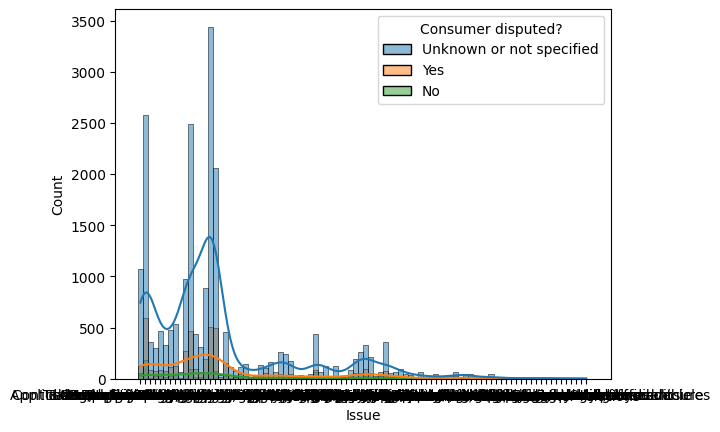

In [121]:
sns.histplot(data=df, x= "Issue",  kde=True, hue="Consumer disputed?")

No parece que haya demasiada diferencia entre las poblaciones

----

In [122]:
df["Sub-issue"].unique().tolist()

['Frequent or repeated calls',
 'Debt is not mine',
 'Unknown or not specified',
 'Debt resulted from identity theft',
 'Called after sent written cease of comm',
 'Debt was paid',
 'Threatened arrest/jail if do not pay',
 'Impersonated an attorney or official',
 'Not given enough info to verify debt',
 'Attempted to collect wrong amount',
 'Used obscene/profane/abusive language',
 'Right to dispute notice not received',
 'Contacted employer after asked not to',
 'Contacted me after I asked not to',
 'Threatened to take legal action',
 'Account terms',
 'Debt was discharged in bankruptcy',
 'Account status',
 'Threatened to sue on too old debt',
 'Investigation took too long',
 'Personal information',
 'Called outside of 8am-9pm',
 'Public record',
 'Talked to a third party about my debt',
 'Report improperly shared by CRC',
 'Information is not mine',
 'Problem with statement of dispute',
 'Problem getting my free annual report',
 'Problem getting report or credit score',
 'Reinserted

In [123]:
len(df["Sub-issue"].unique().tolist())

47

In [124]:
df[df["Sub-issue"].notnull()]["Product"].unique()

array(['Debt collection', 'Mortgage', 'Credit card', 'Consumer loan',
       'Bank account or service', 'Payday loan', 'Credit reporting',
       'Money transfers', 'Student loan', 'Prepaid card',
       'Other financial service'], dtype=object)

Solo hay subproblemas en eestas categorias de producto

In [125]:
df["Timely response?"].value_counts()

Timely response?
Yes    27444
No       712
Name: count, dtype: int64

<Axes: xlabel='Sub-issue', ylabel='Count'>

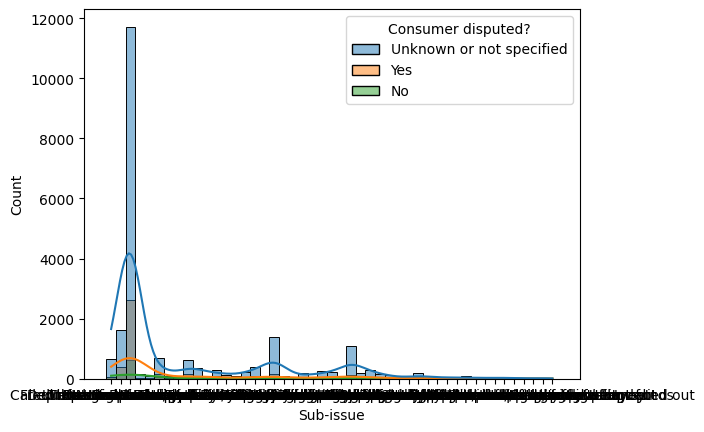

In [126]:
sns.histplot(data=df, x= "Sub-issue",  kde=True, hue="Consumer disputed?")

Sub issue se diferencia mas en algunos valores del medio
---

In [127]:
df["Consumer disputed?"].value_counts()

Consumer disputed?
Unknown or not specified    22150
Yes                          4708
No                           1298
Name: count, dtype: int64

In [128]:
df["Consumer disputed?"].groupby(df["Company response"]).value_counts()

Company response                 Consumer disputed?      
Closed                           Unknown or not specified      460
                                 Yes                           114
                                 No                             32
Closed with explanation          Unknown or not specified    14443
                                 Yes                          3986
                                 No                            952
Closed with monetary relief      Unknown or not specified     1289
                                 Yes                           155
                                 No                             90
Closed with non-monetary relief  Unknown or not specified     2916
                                 Yes                           453
                                 No                            224
In progress                      Unknown or not specified     2690
Untimely response                Unknown or not specified      352
Name

Solo hay unas 6000 disputas, el resto esta vacio y como ya existe la categoria No voy a interpretar los faltantes como desconocidos y basicamente ignorarlos la mayoria del tiempo

<Axes: xlabel='Company response', ylabel='Count'>

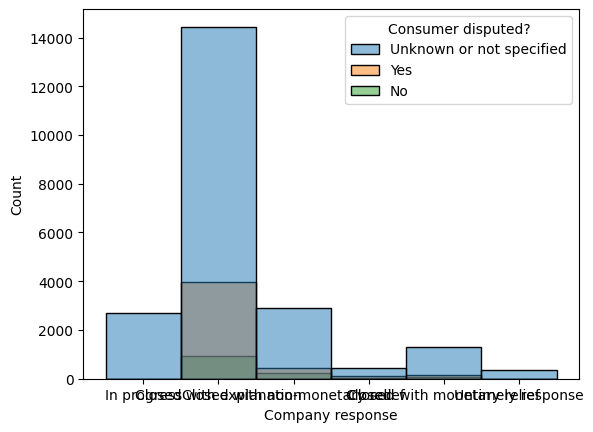

In [129]:
sns.histplot(data=df, x= "Company response",   hue="Consumer disputed?")

No parece que no hay tanta diferenia

---

In [130]:
df[df["Consumer disputed?"].isnull()]["Timely response?"].value_counts()

Series([], Name: count, dtype: int64)

<Axes: xlabel='Timely response?', ylabel='Count'>

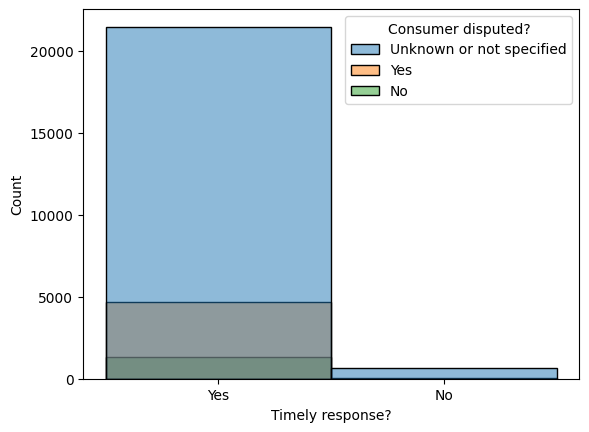

In [131]:
sns.histplot(data=df, x= "Timely response?",   hue="Consumer disputed?")

No hay datos suficientes (No hay Consumer disputed yen Timely response no)

Algunos nan es porque estan en progreso el resto no se puede asegurar que NO el consumidos no va a disputar a si que es posible que hayra que poner poner a los inprogres  in progress y el resto unknown

---

<Axes: xlabel='Date sent to company', ylabel='Count'>

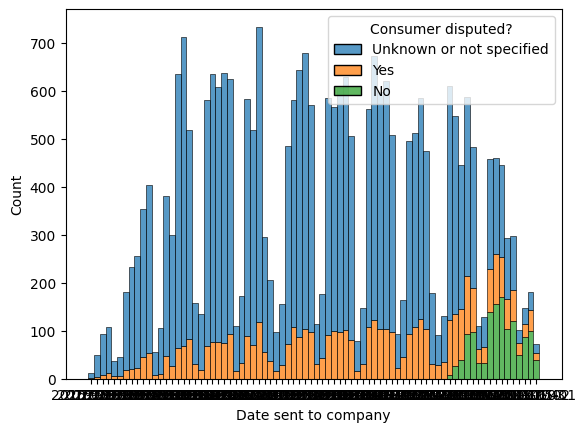

In [132]:
sns.histplot(data=df, x= "Date sent to company", multiple="stack" , hue="Consumer disputed?", bins=50)


Tiene sentido que solo los mas antiguos ( hasta la primera quincena de enero) se sesabe que no hayan disputado, el resto de casos estaran vacios. Esto hace que la fecha no sea demasiado fiable para predecirlo ya que el modelo solo va a decir que no a de las fechas 2015-01-1 hasta 2015-01-15.
Esto es mas interesante todas las variables hasta ahora

---

In [133]:
df["Company"].nunique()

1534

In [134]:
df["Company"].unique().tolist()

['Premium Asset Services, LLC',
 'Accounts Receivable Consultants Inc.',
 'RBS Citizens',
 'Navy FCU',
 'Transworld Systems Inc.',
 'ACE Cash Express Inc.',
 'CashCall, Inc.',
 'Credit Protection Association, L.P.',
 'Cottonwood Financial Ltd.',
 'Niagara Portfolio Solutions LLC',
 'Santander Bank US',
 'FAIR COLLECTIONS & OUTSOURCING, INC.',
 'Account Liquidation Services Inc.',
 'Expert Global Solutions, Inc.',
 'Mercantile Adjustment Bureau, LLC',
 'Amsher Collection Services, Inc.',
 'Recovery One, LLC',
 'CMRE Financial Services, Inc.',
 'Flagstar Bank',
 'Rent Recovery Solutions',
 'Municipal Collections Services, Inc.',
 'Ally Financial Inc.',
 'JPMorgan Chase',
 'TransUnion',
 'Wells Fargo',
 'Bayview Loan Servicing, LLC',
 'CCS Financial Services, Inc.',
 'Aldous & Associates, PLLC',
 'Debt Recovery Solutions, LLC',
 'Fenton & McGarvey Law Firm, P.S.C.',
 'MoneyGram',
 'Early Warning Services, LLC',
 'BMO Harris',
 'Amex',
 'Stellar Recovery Inc.',
 'Synergetic Communication I

In [135]:
df["Company"].unique()

array(['Premium Asset Services, LLC',
       'Accounts Receivable Consultants Inc.', 'RBS Citizens', ...,
       'Cohen McNeile & Pappas, PC', 'United Accounts, Inc.',
       'Allied International Credit Corporation'], dtype=object)

In [136]:
df[df["Consumer disputed?"]!="Unknown or not specified"].head()

,Complaint ID,Product,Sub-product,Issue,Sub-issue,State,ZIP code,Date received,Date sent to company,Company,Company response,Timely response?,Consumer disputed?
2,1290564,Mortgage,FHA mortgage,"Application, originator, mortgage broker",Unknown or not specified,MA,2127.0,2015-03-19,2015-03-19,RBS Citizens,Closed with explanation,Yes,Yes
6,1288848,Consumer loan,Installment loan,Managing the loan or lease,Unknown or not specified,OH,44241.0,2015-03-18,2015-03-18,"CashCall, Inc.",Closed with explanation,Yes,Yes
9,1288304,Debt collection,Payday loan,Taking/threatening an illegal action,Threatened arrest/jail if do not pay,TX,77433.0,2015-03-18,2015-03-18,Cottonwood Financial Ltd.,Closed with explanation,Yes,Yes
14,1289900,Debt collection,"Other (phone, health club, etc.)",Disclosure verification of debt,Not given enough info to verify debt,UT,84405.0,2015-03-18,2015-03-18,Account Liquidation Services Inc.,Closed with non-monetary relief,Yes,Yes
22,1289844,Debt collection,Unknown or not specified,Improper contact or sharing of info,Contacted me after I asked not to,IL,60411.0,2015-03-18,2015-03-18,"Municipal Collections Services, Inc.",Closed with explanation,Yes,Yes


<Axes: xlabel='Company', ylabel='Count'>

C:\Users\unaif\AppData\Roaming\Python\Python312\site-packages\IPython\core\events.py:82: UserWarning: Glyph 133 (\x85) missing from font(s) DejaVu Sans.
  func(*args, **kwargs)
C:\Users\unaif\AppData\Roaming\Python\Python312\site-packages\IPython\core\pylabtools.py:170: UserWarning: Glyph 133 (\x85) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


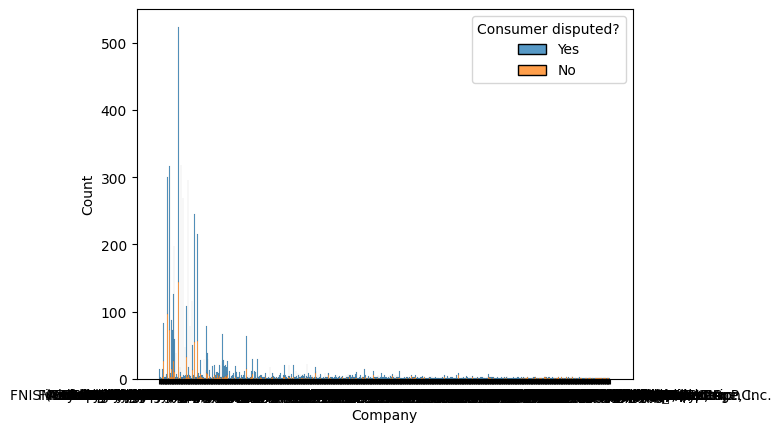

In [137]:
sns.histplot(data=df[df["Consumer disputed?"]!="Unknown or not specified"], x= "Company",   hue="Consumer disputed?", multiple='stack',discrete=True)

---

# Features añadidas en limpieza
* dias de retraso: inutil porque parece que en todos es 0 no se pondra
* weekday  a lo mejor el dia de la semana tiene importancia       
* holiday lo  mismo
---

In [138]:
df["Date received"] = pd.to_datetime(df["Date received"], format="%Y-%m-%d")
import  holidays
df["Date sent to company"] = pd.to_datetime(df["Date sent to company"], format="%Y-%m-%d")
df["weekday"]=df["Date received"].dt.weekday
df["dias de retraso"]=(df["Date sent to company"]-df["Date received"]).dt.days
df["dias de retraso"]
us_holidays = holidays.US()
df["holiday"]= df["Date received"].isin(us_holidays)
from datetime import timedelta
df["holiday_next"]= (df["Date received"]+ timedelta(days=1)).isin(us_holidays)


In [139]:
df["dias de retraso"].value_counts()

dias de retraso
0     12987
1      4352
5      2043
6      1850
3      1684
7      1522
4      1016
2       606
8       373
9       178
10      135
13      116
11      106
19       94
12       81
14       81
15       78
21       76
18       63
20       59
17       58
16       55
22       46
35       38
27       37
26       34
23       31
42       30
24       30
36       28
25       27
30       26
28       24
29       24
31       23
34       20
32       15
39       14
37       13
43       12
33       11
38        9
45        9
41        8
40        7
46        6
44        6
48        4
61        2
47        2
59        1
64        1
57        1
60        1
53        1
52        1
55        1
Name: count, dtype: int64

---
# Skrub

In [140]:
from skrub import TableReport
TableReport(df.fillna("not_specified"))

Processing column  17 / 17


,,,,,,,,,,,,,,,,,


<Axes: xlabel='weekday'>

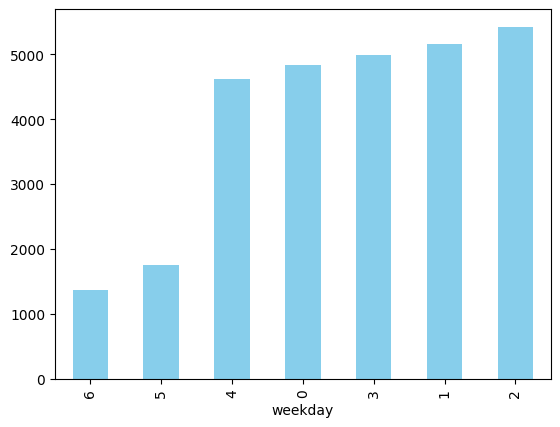

In [141]:
df["weekday"].value_counts().sort_values().plot(kind="bar", color="skyblue")

<Axes: xlabel='weekday', ylabel='Count'>

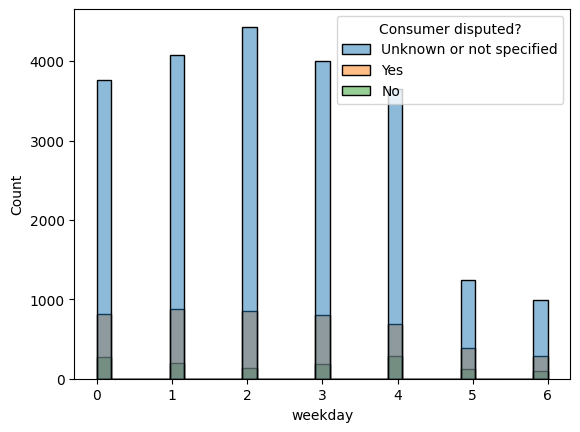

In [142]:
sns.histplot(data=df, x= "weekday",   hue="Consumer disputed?")

In [143]:
df["Consumer disputed?"].value_counts()/len(df["Consumer disputed?"])

Consumer disputed?
Unknown or not specified    0.786688
Yes                         0.167211
No                          0.046100
Name: count, dtype: float64

<Axes: xlabel='Timely response?', ylabel='Count'>

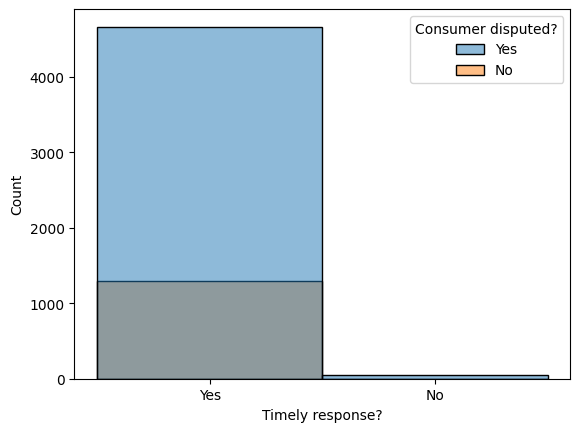

In [144]:
sns.histplot(data=df[df["Consumer disputed?"]!="Unknown or not specified"], x= "Timely response?",   hue="Consumer disputed?")

Todos los casos de los que no se respondio a tiempo el consumido disputo

In [145]:
display(df.groupby("weekday")["Consumer disputed?"].value_counts())

weekday  Consumer disputed?      
0        Unknown or not specified    3758
         Yes                          814
         No                           271
1        Unknown or not specified    4078
         Yes                          874
         No                           200
2        Unknown or not specified    4433
         Yes                          855
         No                           136
3        Unknown or not specified    3998
         Yes                          804
         No                           181
4        Unknown or not specified    3644
         Yes                          688
         No                           292
5        Unknown or not specified    1246
         Yes                          383
         No                           127
6        Unknown or not specified     993
         Yes                          290
         No                            91
Name: count, dtype: int64


Prece que las fechas estan en orden.
El producto que mas problemas da es debt collection parece que motgage es el que los subr¡prbleas son mas comunes.
La respuesta de la compañia es lo que mas importa con una respuesta a tiempo (0.7 de Cramer). Sin embargo, parece que el producto no tiene demasiada importancia en la respuesta.

Parece que todos los dias son laborables( y el dia siguiente tambien),  aunque haya  muchas menos quejas los fines de semana.
Los problemas y productos estan relacionados con subproblemas y subproductos respectivamente.



---

In [146]:
TableReport(df[['Company', 'Company response', 'Timely response?', 'Consumer disputed?']].fillna("not_specified"))

Processing column   4 / 4


<TableReport: use .open() to display>

In [147]:
TableReport(df[['ZIP code', 'Company response', 'Timely response?', 'Consumer disputed?']].fillna("not_specified"))

Processing column   4 / 4


<TableReport: use .open() to display>

Sin embarg parece que la compañia no tiene demasiada o,portandia en la respuenta en el tinempo ni si el comidor disputara la 

In [148]:
TableReport(df[['Company', 'Company response', 'Timely response?', 'Consumer disputed?']])

Processing column   4 / 4


<TableReport: use .open() to display>

In [149]:
df[df["Timely response?"]=="Yes"]['Consumer disputed?'].value_counts()

Consumer disputed?
Unknown or not specified    21485
Yes                          4661
No                           1298
Name: count, dtype: int64

In [150]:
df[df["Timely response?"]=="No"]['Consumer disputed?'].value_counts()

Consumer disputed?
Unknown or not specified    665
Yes                          47
Name: count, dtype: int64

QUe la empresa haya respndido a tiempo no quiere decir que el cliente no vaya a protestar. 
Tambien esta el problema de que hay muy pocar Consumet diputed

In [151]:
display(df['Company response'].groupby(df['Timely response?']).value_counts())

Timely response?  Company response               
No                Untimely response                    351
                  Closed with explanation              233
                  In progress                           57
                  Closed                                37
                  Closed with non-monetary relief       25
                  Closed with monetary relief            9
Yes               Closed with explanation            19148
                  Closed with non-monetary relief     3568
                  In progress                         2633
                  Closed with monetary relief         1525
                  Closed                               569
                  Untimely response                      1
Name: count, dtype: int64

In [152]:
display(df['Company response'].groupby(df['Timely response?']).value_counts()["No"]/712*100)
df['Company response'].groupby(df['Timely response?']).value_counts()["No"].sum()

Company response
Untimely response                  49.297753
Closed with explanation            32.724719
In progress                         8.005618
Closed                              5.196629
Closed with non-monetary relief     3.511236
Closed with monetary relief         1.264045
Name: count, dtype: float64

np.int64(712)

In [153]:
display(df['Company response'].groupby(df['Timely response?']).value_counts()["Yes"]/27444*100)
df['Company response'].groupby(df['Timely response?']).value_counts()["Yes"].sum()

Company response
Closed with explanation            69.771170
Closed with non-monetary relief    13.001020
In progress                         9.594082
Closed with monetary relief         5.556770
Closed                              2.073313
Untimely response                   0.003644
Name: count, dtype: float64

np.int64(27444)

In [154]:
df['Company response'].groupby(df['Timely response?']).value_counts().sum()

np.int64(28156)

| Timely response?         | Porcentaje (%) YES | Porcentaje (%) - NO |
| ------------------------------- | ---------------------- | ---------------------- |
| Closed with explanation         | 69.77                  | 32.72                  |
| Closed with non-monetary relief | 13.00                  | 3.51                   |
| In progress                     | 9.59                   | 8.01                   |
| Closed with monetary relief     | 5.56                   | 1.26                   |
| Closed                          | 2.07                   | 5.20                   |
| Untimely response               | 0.00                   | 49.30                  |


Las respuestas a tiempo dan explicaciones y sueler dar alivios mas a menudo, al contrario de lo esperable.

son mas comunes en las Untimely response.
Esto serivira mucho para timely respone algo que se ve en em modelo

La respuesta de la compañia es algo distinta dependiendo timelye response


---

In [155]:
display(df['Company response'].groupby(df['Consumer disputed?']).value_counts()["Yes"]/4708*100)
df['Company response'].groupby(df['Consumer disputed?']).value_counts()["Yes"].sum()

Company response
Closed with explanation            84.664401
Closed with non-monetary relief     9.621920
Closed with monetary relief         3.292268
Closed                              2.421410
Name: count, dtype: float64

np.int64(4708)

In [156]:
display(df['Company response'].groupby(df['Consumer disputed?']).value_counts()["No"]/1298*100)
df['Company response'].groupby(df['Consumer disputed?']).value_counts()["No"].sum()

Company response
Closed with explanation            73.343606
Closed with non-monetary relief    17.257319
Closed with monetary relief         6.933744
Closed                              2.465331
Name: count, dtype: float64

np.int64(1298)

| Consumer disputed?            | Porcentaje (%) - YES | Porcentaje (%) - NO |
| ------------------------------- | ---------------------- | ---------------------- |
| Closed with explanation         | 84.66                  | 73.34                  |
| Closed with non-monetary relief | 9.62                   | 17.26                  |
| Closed with monetary relief     | 3.29                   | 6.93                   |
| Closed                          | 2.42                   | 2.47                   |
|Total|                              4708               |                      1298|


* Las disputas del consumidor hace que las empresas den explicaciones más detalladas, aunque al contrario de lo esperable reduce la probabilidad de alivio monetario..

* Cuando el consumidor no disputa, es más facil que haya habido alguna forma de compensación  monetaria.
---

In [157]:
display((df['Issue'].groupby(df['Consumer disputed?']).value_counts()["No"]/1298)*100, )
df['Issue'].groupby(df['Consumer disputed?']).value_counts()["No"].sum()

Issue
Incorrect information on credit report      17.334361
Cont'd attempts collect debt not owed       13.790447
Loan modification,collection,foreclosure     7.164869
Loan servicing, payments, escrow account     5.855162
Unable to get credit report/credit score     4.776579
Communication tactics                        4.545455
Account opening, closing, or management      4.468413
Disclosure verification of debt              4.160247
Deposits and withdrawals                     2.927581
Managing the loan or lease                   2.388290
Billing disputes                             2.311248
False statements or representation           2.234206
Dealing with my lender or servicer           2.157165
Other                                        2.003082
Credit reporting company's investigation     1.926040
Problems caused by my funds being low        1.771957
Improper contact or sharing of info          1.386749
Can't repay my loan                          1.232666
Late fee              

np.int64(1298)

In [158]:
import pandas as pd

pd.set_option('display.max_rows', None)  # Muestra todas las filas

result = (df['Issue'].groupby(df['Consumer disputed?']).value_counts()["Yes"] / 4708) * 100
display(result)


Issue
Cont'd attempts collect debt not owed       12.701784
Incorrect information on credit report      10.726423
Loan servicing, payments, escrow account    10.450297
Loan modification,collection,foreclosure     9.940527
Disclosure verification of debt              5.777400
Account opening, closing, or management      4.184367
Credit reporting company's investigation     3.228547
Communication tactics                        2.591334
Deposits and withdrawals                     2.548853
False statements or representation           2.463891
Improper contact or sharing of info          2.060323
Billing disputes                             1.975361
Managing the loan or lease                   1.911640
Application, originator, mortgage broker     1.869159
Unable to get credit report/credit score     1.720476
Dealing with my lender or servicer           1.677995
Taking/threatening an illegal action         1.529312
Other                                        1.508071
Problems when you are 

In [159]:
result = (df['Issue'].groupby(df['Consumer disputed?']).value_counts()["No"] / 1298) * 100
display(result)

Issue
Incorrect information on credit report      17.334361
Cont'd attempts collect debt not owed       13.790447
Loan modification,collection,foreclosure     7.164869
Loan servicing, payments, escrow account     5.855162
Unable to get credit report/credit score     4.776579
Communication tactics                        4.545455
Account opening, closing, or management      4.468413
Disclosure verification of debt              4.160247
Deposits and withdrawals                     2.927581
Managing the loan or lease                   2.388290
Billing disputes                             2.311248
False statements or representation           2.234206
Dealing with my lender or servicer           2.157165
Other                                        2.003082
Credit reporting company's investigation     1.926040
Problems caused by my funds being low        1.771957
Improper contact or sharing of info          1.386749
Can't repay my loan                          1.232666
Late fee              

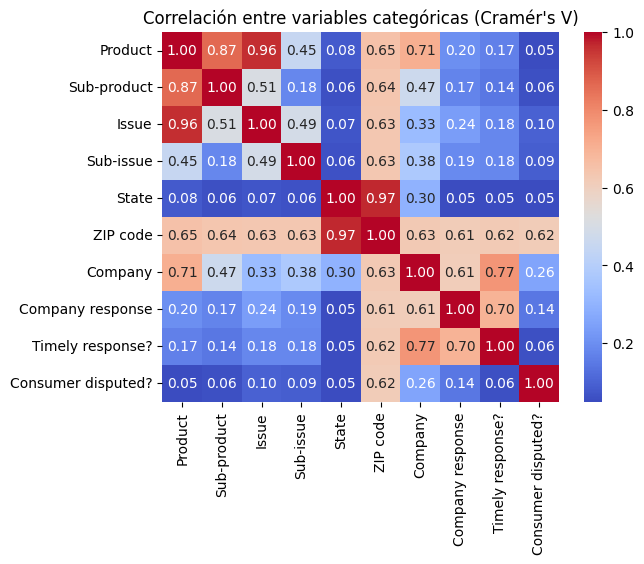

In [160]:
import pandas as pd
import numpy as np
from scipy.stats import chi2_contingency

def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2 / n
    r,k = confusion_matrix.shape
    return np.sqrt(phi2 / min(k-1, r-1))

# Crear matriz de Cramér's V
cols = df.select_dtypes(include='object').columns
cramers_matrix = pd.DataFrame(np.zeros((len(cols), len(cols))), index=cols, columns=cols)

for i in cols:
    for j in cols:
        cramers_matrix.loc[i,j] = cramers_v(df[i], df[j])

sns.heatmap(cramers_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlación entre variables categóricas (Cramér's V)")
plt.show()

PArece que no hay mucha diferencia entre con los problemas


# Resumen de la fuente

* **Complaint ID**: ID de la queja
* **Product**:	Producto al que hace referencia la queja. Hay 11 productos en total. No esta equilibrado. 
    * Debt collection            
    * Mortgage                   
    * Credit reporting           
    * Credit card               
    * Bank account or service    
    * Consumer loan              
    * Student loan               
    * Payday loan                 
    * Money transfers            
    * Prepaid card               
    * Other financial service 
Se añade la etiqueta "Unlnow or not speficied"    
     
* **Sub-product**: DEstro de un producto la parte concreta. La mayoria esta vacia. Solo los 'Debt collection', 'Mortgage', 'Consumer loan',
       'Bank account or service', 'Money transfers', 'Student loan',
       'Prepaid card', 'Other financial servicetienen subproductos. "Debt collection" tambien tiene alguna queja en la que no tiene subproducto.
       Se añade la etiqueta "Unlnow or not speficied"  
 El resto to tiene subproducto.(Ver celda de mas abajo)

* **Issue**	: Hay 90 categorias pero teniendo en cuenta que hay 27000 muestras es baja cardinalidad

* **Sub-issue**	:Solo 'Debt collection', 'Credit reporting' tienen esto y hay 47 distintas (mirar mas abajo para detalles). El resto es una categoria vacia. Se rellenara con una etiquta

* **State**	: Son los 50 estados de EEUU, otros territorios controlados por el(	Puerto Rico, Islas Vírgenes, Guam, Samoa Americana, Islas Marshall, Palaos ) y dos designagiones militares (AE es europea, y AP del pacifico). Hay valores faltantes. Algunos de estos si que tienen codigo Zip.  Se va a ñadir el estado unknown y se intentara sacarSe usara label encoder debido a que solo hay unos 60 distintos

* **ZIP code**: Hay varias que que no tienen estado pero si postal. Se podria intentar sacar el estado e  ignorar esta variable para evitar problemas de prvaciad. Se usara laber encoder debido a que solo hay unos 60 distintos. Por privacidad, y porque es una categoria numerica de alta cardinalidad no se utilizara. Ademas la info ya esta en State.

* **Date received**	: Fecha que llego

* **Date sent to company**	:Fecha que llego a la compañia parece que en todos los casos llega.
    * **dias de retraso** La mayoria son 0, aunque hay una minroa que tarda mas en recibirse, y una menor que tarda aun mas. es la unica variable numerica. No parece que se relacione los casos que se recibio el mismo dia sean timely response.

* **Company**	:hay como 1500 y siemmpre hay. No parece importante, para dispute, pero si para timely. Sin embargo es una variable de alta cardinalidad. No se usara en timely para evitar mala publicidad de las empresas( aunque parece que no lo necesita) y porque el modelo de timely es un arbol, y funciona mejor con label encoders.

* **Company response**:	Siempre tiene y son:
    * 'In progress' 
    * 'Closed with explanation'
    * 'Closed with non-monetary relief'
    * 'Closed'
    * 'Closed with monetary relief'
    * 'Untimely response'
    Un label encoder es adecuado. Esta b¡muy desbalanceado con 'Closed with explanation' siendo el mas frecuente

* **Timely response?**	: Si y no, pero solo hay como 700 quejas que no se han respondido a tiempo.

* **Consumer disputed?**: estan si , no, y nan. Desbalanceado. La inmensa mayoria es NaN. las que estan in progress tiene sentido que esten vacias. Se interpretara como vacias/ aun se desconoce si va ha disputar. Solo en los casos mas antiguos 


Parece para la mayoria de variables  hay una diferencia de poblacion segun comsumer response quitando las fechas, aunque esto seguramente se deba a que aun no se ha confirmado que el consumidor vaya a disputar.

---

## Subproductos
### Debt collection
- nan  
- Medical  
- Non-federal student loan  
- Payday loan  
- Other (phone, health club, etc.)  
- Credit card  
- Mortgage  
- Auto  
- Federal student loan  

### Mortgage
- FHA mortgage  
- Conventional adjustable mortgage (ARM)  
- Conventional fixed mortgage  
- Home equity loan or line of credit  
- Other mortgage  
- VA mortgage  
- Reverse mortgage  

### Consumer loan
- Installment loan  
- Vehicle loan  
- Personal line of credit  
- Vehicle lease  
- Pawn loan  
- Title loan  

### Bank account or service
- Other bank product/service  
- Checking account  
- (CD) Certificate of deposit  
- Savings account  
- Cashing a check without an account  

### Money transfers
- Domestic (US) money transfer  
- International money transfer  

### Student loan
- Non-federal student loan  

### Prepaid card
- General purpose card  
- Other special purpose card  
- Gift or merchant card  
- Mobile wallet  
- Payroll card  
- Government benefit payment card  
- ID prepaid card  

### Other financial service
- Check cashing  
- Debt settlement  
- Money order  
- Refund anticipation check  
- Traveler's/Cashier's checks  
- Foreign currency exchange  
- Credit repair

---

## Issues por producto
### Debt collection
- Communication tactics  
- Cont'd attempts collect debt not owed  
- Taking/threatening an illegal action  
- False statements or representation  
- Disclosure verification of debt  
- Improper contact or sharing of info  

### Mortgage
- Application, originator, mortgage broker  
- Loan modification, collection, foreclosure  
- Loan servicing, payments, escrow account  
- Credit decision / Underwriting  
- Settlement process and costs  
- Other  

### Credit card
- Other  
- Delinquent account  
- Late fee  
- Billing statement  
- Cash advance fee  
- APR or interest rate  
- Closing/Cancelling account  
- Billing disputes  
- Identity theft / Fraud / Embezzlement  
- Bankruptcy  
- Credit card protection / Debt protection  
- Payoff process  
- Credit determination  
- Customer service / Customer relations  
- Unsolicited issuance of credit card  
- Privacy  
- Transaction issue  
- Application processing delay  
- Balance transfer fee  
- Credit line increase/decrease  
- Balance transfer  
- Advertising and marketing  
- Rewards  
- Overlimit fee  
- Cash advance  
- Other fee  
- Forbearance / Workout plans  
- Sale of account  
- Convenience checks  
- Arbitration  

### Consumer loan
- Managing the loan or lease  
- Problems when you are unable to pay  
- Taking out the loan or lease  
- Managing the line of credit  
- Shopping for a loan or lease  
- Charged fees or interest I didn't expect  
- Can't contact lender  
- Applied for loan/did not receive money  
- Account terms and changes  
- Received a loan I didn't apply for  
- Payment to acct not credited  
- Lender repossessed or sold the vehicle  
- Lender damaged or destroyed vehicle  
- Shopping for a line of credit  

### Bank account or service
- Deposits and withdrawals  
- Account opening, closing, or management  
- Using a debit or ATM card  
- Problems caused by my funds being low  
- Making/receiving payments, sending money  
- nan  

### Payday loan
- Can't contact lender  
- Can't stop charges to bank account  
- Charged fees or interest I didn't expect  
- Charged bank acct wrong day or amt  
- Received a loan I didn't apply for  
- Payment to acct not credited  
- Applied for loan/did not receive money  

### Credit reporting
- Incorrect information on credit report  
- Credit reporting company's investigation  
- Improper use of my credit report  
- Unable to get credit report/credit score  
- Credit monitoring or identity protection  

### Money transfers
- Other transaction issues  
- Other service issues  
- Money was not available when promised  
- Fraud or scam  
- Wrong amount charged or received  
- Incorrect/missing disclosures or info  

### Student loan
- Can't repay my loan  
- Getting a loan  
- Dealing with my lender or servicer  

### Prepaid card
- Unauthorized transactions/trans. issues  
- Managing, opening, or closing account  
- Fraud or scam  
- Overdraft, savings or rewards features  
- Adding money  
- Fees  
- Advertising, marketing or disclosures  

### Other financial service
- Disclosures  
- Fraud or scam  
- Lost or stolen money order  
- Customer service/Customer relations  
- Lost or stolen check  
- Incorrect exchange rate  
- Unexpected/Other fees  
- Excessive fees  

## Sub problemas de cada problema
### Communication tactics
- Frequent or repeated calls  
- Called after sent written cease of comm  
- Used obscene/profane/abusive language  
- Threatened to take legal action  
- Called outside of 8am-9pm  

### Cont'd attempts collect debt not owed
- Debt is not mine  
- Debt resulted from identity theft  
- Debt was paid  
- Debt was discharged in bankruptcy  

### Taking/threatening an illegal action
- Threatened arrest/jail if do not pay  
- Threatened to sue on too old debt  
- Sued w/o proper notification of suit  
- Seized/Attempted to seize property  
- Sued where didn't live/sign for debt  
- Attempted to/Collected exempt funds  

### False statements or representation
- Impersonated an attorney or official  
- Attempted to collect wrong amount  
- Indicated committed crime not paying  
- Indicated shouldn't respond to lawsuit  

### Disclosure verification of debt
- Not given enough info to verify debt  
- Right to dispute notice not received  
- Not disclosed as an attempt to collect  

### Improper contact or sharing of info
- Contacted employer after asked not to  
- Contacted me after I asked not to  
- Talked to a third party about my debt  
- Contacted me instead of my attorney  

### Incorrect information on credit report
- Account terms  
- Account status  
- Personal information  
- Public record  
- Information is not mine  
- Reinserted previously deleted info  

### Credit reporting company's investigation
- Investigation took too long  
- Problem with statement of dispute  
- No notice of investigation status/result  
- Inadequate help over the phone  

### Improper use of my credit report
- Report improperly shared by CRC  
- Report shared with employer w/o consent  
- Received marketing offer after opted out  

### Unable to get credit report/credit score
- Problem getting my free annual report  
- Problem getting report or credit score  

### Credit monitoring or identity protection
- Billing dispute  
- Problem with fraud alerts  
- Problem cancelling or closing account  
- Receiving unwanted marketing/advertising  
- Account terms and changes  

